#**FINAL REPORT**

**Objective**: Our project idea is to make an application that can accurately classify a “[Hechsher](https://en.wikipedia.org/wiki/Hechsher#:~:text=A%20hechsher%20)” or kosher certification symbol given a picture of it on a product.
In the kosher-keeping community there are many different views on what standards need to be met in order for a food to qualify as kosher. As a result, there are many kosher certifying agencies which require different guidelines to be met before they give their stamp of approval. It is extremely common for some people to feel comfortable with one certifying agency and not others. 
Since some kosher symbols are far more prevalent than others, many kosher-observant Jews are not familiar with the rarer symbols they encounter, and therefore need more information about the certifying agency for that symbol before purchasing. Additionally, different countries around the world have their own sets of kosher symbols, which are often unrecognizable to visitors from other countries. 
If our classifier for kosher symbols is adequate, kosher-observant Jews could use our application to identify the certifying agency (and perhaps other details) of unfamiliar kosher symbols on both local and international products and then use that information to determine if they feel comfortable with that agency. 

**Data Collection**:

One of the major portions of this project was the data collection involved in assembling our own dataset. Gathering data is a time intensive process and the poor weather and pandemic made it even harder to go out and take pictures. We all together managed to collect about **x** images from **y** classes. We used 3 methods for gathering data:
1. Going into supermarkets and photographing the symbols on their food items.
2. Searching through the web and facebook to see what photos we can gather.
3. Social Media - We posted on multiple Jewish facebook groups with tens of thousands of followers telling them about our idea and asking for help by collecting images. We set up an email for them to share their collected data.
4. Mass emailing - We first wrote a python script to go through some of the websites and gather the names and email addresses of all the main certifying agencies. In total we got the information of a few hundred agencies. Then we wrote another python script to automatedly email all of them a personalized email explaining to them out project and requesting pictures of their symbol on food items. Many of them responded and provided helpful data.

Additionally we decided to add more artificial pictures to our data by taking the various symbols of these companies and augmenting them onto randomly generated background with various sizes and orientations. This is seperate from the augmentation done on the real world collected data. The combination of the real world collected data and the logos randomly placed onto different backgrounds formed our dataset. Adding the logo images gave us a boost of up to 10% in some cases. 

**Classification Methods**

We used 4 categories of models for our artificial neural network:
1. Base Model: This is a convolutional neural network with a fairly classical small convolutionalal architectures to classify images. 
2. Transfer Learning without fine tuning: This model uses transfer learning based on the exception model trained on imagenet weights. We add a new head consisting of a GlobalAveragePooling2D layer and a Dense Keras prediction layer at the end of the network to apply the network to our task. The part of the model imported from the exception model was not trainable.
3. Transfer Learning with fine tuning: This is the same model as architecture 2 but we allowed the weights in the exception model to be trainable and fine tuned by our dataset.
4. Keras Tuner: We wanted to test out different designs of these architectures empirically so we used Keras Tuner to find the right combination of convolutional layers, filters, dense layers etc. to maximize our validation accuracy. This of course took many hours to run as it has to make and compare many neural networks but it is the most effective way to design an architecture.

Our networks were trained with 3 callbacks functions:
1. Tensorboard Callback: This allows us to use the tensorboard profiler which allows us to get a more accurate picture of how the network is performing. It makes a javascript object that is manipulatable and better allows us to understand the network, adjust hyperparameters, and improve our dataset.
2. Early Stopping: This has the network stop if training for more epochs leads to a decrease in validation accuracy ie. the network is memorizing or overfitting. If the validation accuracy decreases for two straight epochs, training is stopped and the model is left as is. This helps reduce training time when training will only lead to a decrease in validation accuracy. This is essential as we are training many large models especially with Keras Tuner and can allow us to run many more experiments in less time. 
3. Model Choice: After every epoch, the model saves all its information to disk. At the end of training, the best model is selected based on validation accuracy. This way, the model's weights can be taken from before it starts overfitting. 

Because the networks used a validation set during the training process, there is a seperate test set for final evaluation of the classifier's accuracy. 

We also converted our tensorflow model to coreML so that it could be run as part of an IOS application. A video of this application in use will be attatched as a link.


**Experimental Evidence**: There was a big difference in the classification of our networks with transfer learning clearly outperforming non-transfer learning networks and finetuning allowing for a big boost in accuracy. To improve our accuracy going forward the biggest thing is definitely more data collection. There is still significant variability in our dataset and the neural networks ability to generalize the classification task is significant. With transfer learning and finetuning our model can easily get into the mid 90's in terms of accuracy.

**Resources/Files**


1. The google Colab https://colab.research.google.com/drive/1-byy1SJsKc0Sl4oQib-T9yM26JZXM6K3?usp=sharing with our report and code
2. Link to our main dataset: https://drive.google.com/drive/folders/1O6aI3kMPwoLR5feQ6MNFZ_FI89UcwgPa?usp=sharing
3. Link to our Logo dataset: https://drive.google.com/drive/folders/1iTskOHEGoHn_XEzMrJvtC96YyL-m2zSL?usp=sharing
4. Our video: https://www.youtube.com/watch?v=wwTOPJqrAf4&feature=youtu.be
5. All our code is on GitHub including main classifier code, scraping agency info script, emailer script, conversion of keras model to coreML model script: https://github.com/matthew-rosenberg/ADL_Final_Project
6. Powerpoint presentation: https://docs.google.com/presentation/d/1IeXHBY6cN-npWVFYwe-GuHThts0iQxj20mwqdwPztW8/edit?usp=sharing

#**Kosher Symbols**

##**Mount to Drive + Link to Files**


In [2]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [3]:
training_path = r'/content/gdrive/MyDrive/kosher_app_cropped'
!ls $training_path

 1K		      Heart_K			  NSKC
 3LINE		      Hei-k			  OK
 AKC		      IKC			  ORB
 Apple_K	      K				  Oregon_K
 Australia_Kosher     KA			  OU
 badatz		      KAdiamond			  OV
 BCK		      KAJ			  Peru_Kosher
 BDK		      KDM			  RCC
 BFSUCD		      kehila			  Scroll-K
 bird_K		      KLBD			  Seattle_vaad
 BK		      KM			  shield_K
 BKA		      KMD_Mexico_Kosher		  Shield-Star-K
 blue_ribbon_kosher   KMSB			  SHK
 BUOSSAD	      KORC			  SIKS
 BVK		      Kosher_in_Greece		  Star-D
 CCK		      Kosher_Inspection_Service   Star-K
 C_crown	      Kosher_LA			  SW
 Chaf-K		      Kosher_Miami		  Tablet-K
 chinuch	      K-R			  tarnopol
 Cincinatti_vaad      KS			  tartikover
 CinK		      KSA			 'The Kosher App.gslides'
 C-K		      KVH			  TK
 CoR_2		      KV_kosher			  Triangle-K
 cRc		      Magnifying_Glass-Chaf	  US-K
 CRCanada	      manchester		  vismindel
 DK		      mem			  VK
 Earth_Kosher	      Mexico_Kosher		  wisconsin
 eidus		      Midwest_Kosher		  zurich
 Euro_K		      MK
 flag_k		      M

###**Imports**

In [4]:
import cv2
import os
from os import path
import shutil
import pathlib
import IPython.display as display
import matplotlib.pyplot as plt
import random
from sklearn.model_selection import train_test_split
import tensorflow as tf
from PIL import Image
import numpy as np
from skimage import transform
import glob 
from tensorflow import keras
import time
from sklearn.metrics import classification_report

In [5]:
print(keras.__version__)
print(tf.__version__)

2.4.0
2.4.0


## **Data Preprocessing**

### Reused Functions and Constants

In [6]:
# Important costants
IMG_SIZE = 299 #Height and width of training images
TRAIN_BATCH_SIZE = 32 
VAL_BATCH_SIZE = 32
EPOCHS = 20
AUTOTUNE = tf.data.experimental.AUTOTUNE #used for caching data
SHUFFLE_SIZE = 1000 #used for shuffling data
COLOR_CHANNELS = 3 #number of color channels for training data. We considered doing greyscale, but doesn't work with the transfer learning models
min_number_labels = 100 #any label with fewer than x training examples is ignored from the dataset

In [7]:
def plot_history(history, epochs=None):
    """
    Given a history dictionary output of model.fit, display the 
    validation and training accuracies and losses in graph form 
    """
    
    train_accuracies = history.history['acc']
    train_losses = history.history['loss']
    test_accuracies = history.history['val_acc']
    test_losses = history.history['val_loss']

    epochs = epochs or range(len(train_accuracies))

    plt.plot(epochs, train_accuracies, color='blue', label='Train')
    plt.plot(epochs, test_accuracies, color='orange', label='Validation')

    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend()
    plt.show()

    plt.plot(epochs, train_losses, color='blue', label='Train')
    plt.plot(epochs, test_losses, color='orange', label='Validation')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend()
    plt.show()

In [8]:
def show(img, label, num=1):
    """
    Display an image and its label in a nice fashion
    """
    # img_display = tf.squeeze(img)
    plt.figure(num)
    plt.imshow(img)
    plt.title(label)
    plt.xticks([]) #get rid of axis
    plt.yticks([]) #get rid of axis
    print()


In [9]:
def GetClass(fp):
    """
    Given a filepath find its class assuming its class is one directory up
    from the training folder. Used for testing of preprocessing
    Returns a label name as string
    """
    x = os.path.relpath(fp, training_path)
    x = os.path.dirname(x)
    return str(x)

In [10]:
def ApplyTestSet(model, test_set, test_set_labels, output_classes):
    """
    Run a test set against a model. Gets output as recall and precision numbers as well
    as overall accuracies. The recall and precisions numbers are given as a string 
    report as returned by the sklearn library
    Returns loss (float), accuracy (float), and report (string)
    """
    loss, acc = model.evaluate(test_set) #test the best model on an entirely new test set
    y_pred = np.argmax(model.predict(test_set), axis=-1)
    report = classification_report(test_set_labels, y_pred,target_names=output_classes)
    return loss, acc, report

### Get all the data

In [11]:
# Display folders = class names 
!ls $training_path

 1K		      Heart_K			  NSKC
 3LINE		      Hei-k			  OK
 AKC		      IKC			  ORB
 Apple_K	      K				  Oregon_K
 Australia_Kosher     KA			  OU
 badatz		      KAdiamond			  OV
 BCK		      KAJ			  Peru_Kosher
 BDK		      KDM			  RCC
 BFSUCD		      kehila			  Scroll-K
 bird_K		      KLBD			  Seattle_vaad
 BK		      KM			  shield_K
 BKA		      KMD_Mexico_Kosher		  Shield-Star-K
 blue_ribbon_kosher   KMSB			  SHK
 BUOSSAD	      KORC			  SIKS
 BVK		      Kosher_in_Greece		  Star-D
 CCK		      Kosher_Inspection_Service   Star-K
 C_crown	      Kosher_LA			  SW
 Chaf-K		      Kosher_Miami		  Tablet-K
 chinuch	      K-R			  tarnopol
 Cincinatti_vaad      KS			  tartikover
 CinK		      KSA			 'The Kosher App.gslides'
 C-K		      KVH			  TK
 CoR_2		      KV_kosher			  Triangle-K
 cRc		      Magnifying_Glass-Chaf	  US-K
 CRCanada	      manchester		  vismindel
 DK		      mem			  VK
 Earth_Kosher	      Mexico_Kosher		  wisconsin
 eidus		      Midwest_Kosher		  zurich
 Euro_K		      MK
 flag_k		      M

Some data preprocessing: 
- Get all the filepath strings
- Print some data about dataset
- Get all labels names
- Make a dictionary associating each class name to an index

In [12]:
def GetFilesFromPath(data_root, shuffle=True, jpeg=True):
    """
    Given a pathlib path root collect all the data in that directory.
    Assumes only jpeg images are being collected. If jpeg is False it'll collect
    png images. 
    Returns a list of filepath
    """
    # Get all the filepath strings
    print(f"Root path of data {data_root}")

    # Only use Jpegs for now
    if jpeg:
        file_types = ['*/*.jpg', '*/*.jpeg', '*/*.JPG', '*/*.JPEG'] #these are the used files types
    else:
        file_types = ['*/*.png', '*/*.PNG'] #these are the used files types
    all_image_paths = []
    for file_type in file_types:
        all_image_paths.extend(list(data_root.glob(file_type)))

    all_image_paths = [str(path) for path in all_image_paths]
    # random.shuffle(all_image_paths) #Shuffle the image paths
    return all_image_paths

In [13]:
data_root = pathlib.Path(training_path)
all_image_paths = GetFilesFromPath(data_root)

# Print some data about dataset
image_count = len(all_image_paths)
print(f"Number of images: {image_count}")
print(f"Example Paths: {all_image_paths[:3]}")

# Get all label names and  associate each class name to an index
label_names_original = sorted(item.name for item in data_root.glob('*/') if item.is_dir()) #original because will get rid of classes without enough training data
label_to_index_original = dict((name, index) for index, name in enumerate(label_names_original)) #label (string) -> index (int)
index_to_label_original = {v: k for k, v in label_to_index_original.items()} #index (int) -> label (string)
print(f"Class labels: {index_to_label_original}")

all_labels = [label_to_index_original[pathlib.Path(path).parent.name] #get the class label for every filepath
                    for path in all_image_paths]

#all_labels and all_image_paths are corresponding lists with training example and labels respectively
assert len(all_labels), len(all_image_paths)

Root path of data /content/gdrive/MyDrive/kosher_app_cropped
Number of images: 4974
Example Paths: ['/content/gdrive/MyDrive/kosher_app_cropped/zurich/4e6dee01-1160-4d68-a621-6d58febfbdcc copy 3.jpg', '/content/gdrive/MyDrive/kosher_app_cropped/zurich/4e6dee01-1160-4d68-a621-6d58febfbdcc copy 2.jpg', '/content/gdrive/MyDrive/kosher_app_cropped/zurich/4e6dee01-1160-4d68-a621-6d58febfbdcc copy.jpg']
Class labels: {0: '1K', 1: '3LINE', 2: 'AKC', 3: 'Apple_K', 4: 'Australia_Kosher', 5: 'BCK', 6: 'BDK', 7: 'BFSUCD', 8: 'BK', 9: 'BKA', 10: 'BUOSSAD', 11: 'BVK', 12: 'C-K', 13: 'CCK', 14: 'CRCanada', 15: 'C_crown', 16: 'Chaf-K', 17: 'CinK', 18: 'Cincinatti_vaad', 19: 'CoR_2', 20: 'DK', 21: 'Earth_Kosher', 22: 'Euro_K', 23: 'Heart_K', 24: 'Hei-k', 25: 'IKC', 26: 'K', 27: 'K-R', 28: 'KA', 29: 'KAJ', 30: 'KAdiamond', 31: 'KDM', 32: 'KLBD', 33: 'KM', 34: 'KMD_Mexico_Kosher', 35: 'KMSB', 36: 'KORC', 37: 'KS', 38: 'KSA', 39: 'KVH', 40: 'KV_kosher', 41: 'Kosher_Inspection_Service', 42: 'Kosher_LA', 4

Count the number of examples of each class in the dataset. Used to both help us know which labels need more data collection done and which labels should be excluded from the classifier because there is no reasonable chance of correct classification.

In [14]:
from collections import defaultdict 
counter = defaultdict(int)
for file, label in zip(all_image_paths, all_labels):
    counter[label] += 1

print("Class image counts:")
for i, item in enumerate(counter.items()):
    k, v = item
    print(f"  {i + 1:2}) {index_to_label_original[k]:22}:{v:4}")

Class image counts:
   1) zurich                :   4
   2) wisconsin             :   5
   3) VK                    :  40
   4) vismindel             :  20
   5) US-K                  :  22
   6) TK                    :  23
   7) Triangle-K            :  58
   8) Tablet-K              :  99
   9) SW                    :  15
  10) Star-K                : 342
  11) Star-D                :  54
  12) SIKS                  :   3
  13) SHK                   :  21
  14) Scroll-K              :  90
  15) Shield-Star-K         :  33
  16) RCC                   :   3
  17) Peru_Kosher           :  60
  18) OV                    :  23
  19) Oregon_K              :  39
  20) OU                    :1077
  21) OK                    : 406
  22) MK-2                  :  12
  23) MK                    :  54
  24) mem                   :  80
  25) manchester            :  12
  26) Magnifying_Glass-Chaf :  50
  27) KVH                   : 195
  28) KSA                   : 186
  29) Kosher_Miami          

Sanity Check - Make sure the parallel lists still match up. Ie the 10th filepath from *all_image_paths* should have the 10th label from *all_labels*

In [15]:
for i in range(3):
    x = random.randint(0,len(all_image_paths))
    fp = all_image_paths[x]
    label = index_to_label_original[all_labels[x]]
    cls = GetClass(fp)
    assert cls == label
print("Passed")

Passed


### Figure out which classes to keep and which to get rid of based on amount of training data

In [16]:
counted_classes = set() #classes to keep
ignored_classes = set() #classes to get rid of
for cls_index, count in counter.items():
    if count > min_number_labels:
        counted_classes.add(cls_index)
    else:
        ignored_classes.add(cls_index)
num_ignored_labels = len(ignored_classes)
num_counter_labels = len(counted_classes)
num_total_labels = len(counter)
print(f"Number of counted labels = {num_counter_labels}. ")
print(f"Number of ignored labels = {num_ignored_labels}. ")
assert num_ignored_labels + num_counter_labels == num_total_labels #make sure the class totals add up

Number of counted labels = 9. 
Number of ignored labels = 67. 


Get a list of integers/indexes that contain training instances that should be deleted from the dataset. These indexes are for the parallel lists of all_image_paths and all_labels and are the pointers to those instances that are from classes that need to be removed due to a lack of training examples.

In [17]:
num_image_paths = len(all_image_paths) #number of total filepaths in dataset
num_labels_paths = len(all_labels) #Number of total labels in dataset (non-unique)
assert num_image_paths == num_labels_paths #make sure lists are still parallel
print(f"Number images: {num_labels_paths}")

indexes_to_delete = [] 
for i in range(num_labels_paths)[::-1]: #go backward for deletion efficiency from list
    label = all_labels[i]
    if label in ignored_classes:
        indexes_to_delete.append(i)
num_indexes_to_delete = len(indexes_to_delete)
print(f"Num indexes to delete = {num_indexes_to_delete}")

Number images: 4974
Num indexes to delete = 1897


### Delete bad labels and data

In [18]:
for index in indexes_to_delete:
    del all_image_paths[index]
    del all_labels[index]
number_images_final = len(all_image_paths)
number_labels_paths_final = len(all_labels)
print("Done deleting")

Done deleting


Sanity Check - make sure all the numbers still add up.
1. same number of images and labels
2. the number of deleted items = number of original items - the number of current items

Also check to make sure the lists are still parallel (10th label corresponds to 10th image as above etc.)


In [19]:
# Another sanity check - make sure all the  numbers still add up
assert number_images_final == number_labels_paths_final
assert num_indexes_to_delete == (num_image_paths - number_images_final)

for i in range(3):
    x = random.randint(0,len(all_image_paths))
    fp = all_image_paths[x]
    label = index_to_label_original[all_labels[x]]
    cls = GetClass(fp)
    assert cls == label
print("Passed")

Passed


### Reorganize remaining data

We have to give new indexes/integer values to each label and then change all the values of the labels of the images

In [20]:
# Get all label names and  associate each class name to an index
label_names = set() #the  set of label names that we end up using
for index_label in all_labels:
    label = index_to_label_original[index_label]
    label_names.add(label)
label_names = sorted(list(label_names))
print(f"Used label_names: {label_names}")

label_to_index = dict((name, index) for index, name in enumerate(label_names)) #new label -> int dictionary with now fewer number of labels
index_to_label = {v: k for k, v in label_to_index.items()} #new int -> label dictionary
print(f"Class labels: {label_to_index}")

index_converter = dict() #get the conversion from the old numbering system of labels to the new one
for index, label in index_to_label_original.items():
    if index in counted_classes:
        new_index = label_to_index[label]
        index_converter[index] = new_index
index_converter

Used label_names: ['Chaf-K', 'CoR_2', 'KORC', 'KSA', 'KVH', 'OK', 'OU', 'Star-K', 'cRc']
Class labels: {'Chaf-K': 0, 'CoR_2': 1, 'KORC': 2, 'KSA': 3, 'KVH': 4, 'OK': 5, 'OU': 6, 'Star-K': 7, 'cRc': 8}


{16: 0, 19: 1, 36: 2, 38: 3, 39: 4, 51: 5, 53: 6, 65: 7, 74: 8}

In [21]:
all_labels = [index_converter[i] for i in all_labels] #convert all labels from old numbering system (pre-deletion of classes) to new one
assert max(all_labels) == len(index_to_label) - 1 #make the sure the highest label index is the equal to the number of labels - 1 (because 0 indexing)

Again check that the lists are still parallel in terms of images and labels

In [22]:
for i in range(3):
    x = random.randint(0,len(all_image_paths))
    fp = all_image_paths[x]
    label = index_to_label[all_labels[x]]
    cls = GetClass(fp)
    assert cls == label
print("Passed")

Passed


### Display data

Print out some example images to and their classes to get a feel for the dataset

OU


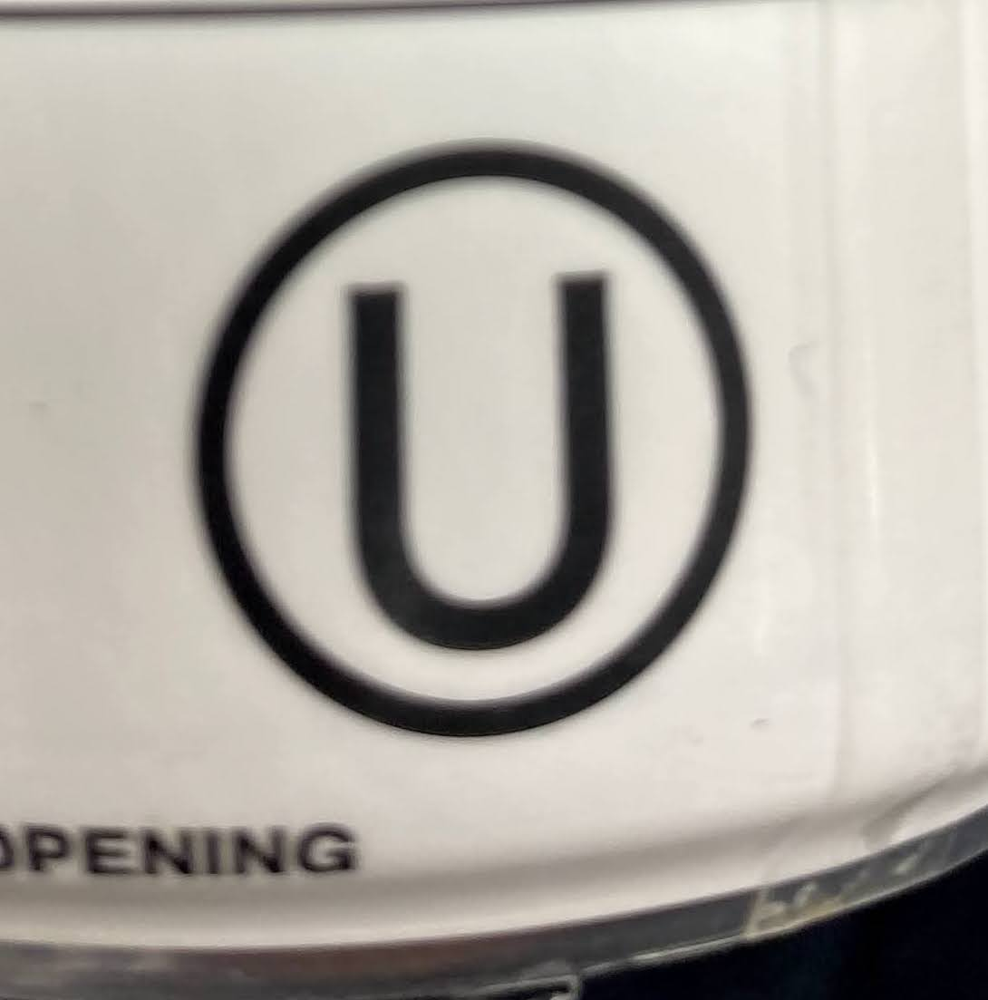



OK


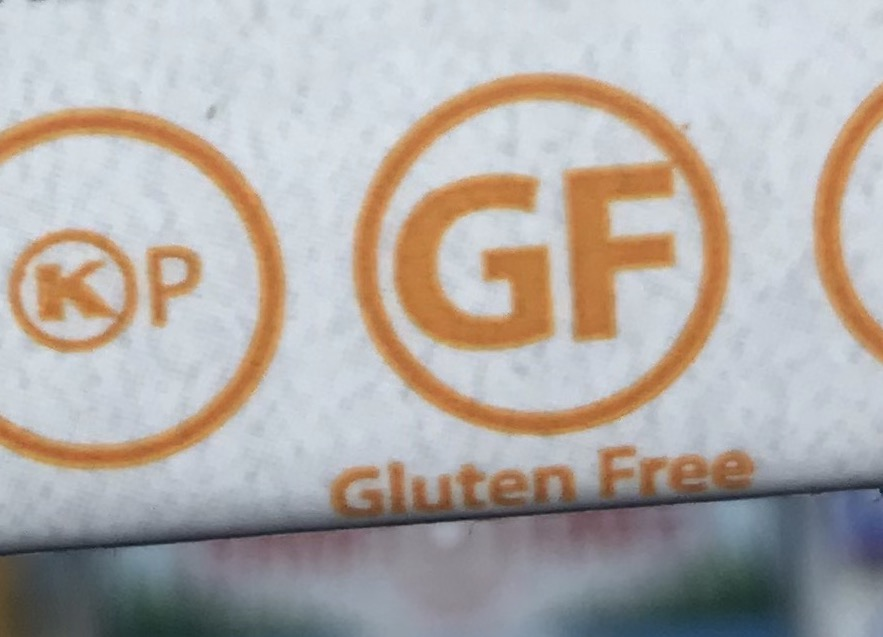

In [23]:
for n in range(2):
  image_path = random.choice(all_image_paths)
  print(GetClass(image_path))
  display.display(display.Image(image_path))
  print("\n")

Look at some information about the pictures to get a better feel of the images.
- raw image
- shape
- size
- type
- min and max values
- normalized data

In [24]:
print("Example image analysis:")
img_raw = tf.io.read_file(all_image_paths[0])
print(f"Raw image: {repr(img_raw)[:100]}...")
img_tensor = tf.image.decode_image(img_raw)
print(f"Image tensor shape: {img_tensor.shape}")
print(f"Image tensor type {img_tensor.dtype}")
img_final = tf.image.resize(img_tensor, [IMG_SIZE, IMG_SIZE])
img_final = img_final / 255.0 # normalize pixel values
# img_final = tf.image.rgb_to_grayscale(img_final)
print(img_final.shape)
print(f"Min normalized value: {img_final.numpy().min()}")
print(f"Max normalized value: {img_final.numpy().max()}")

Example image analysis:
Raw image: <tf.Tensor: shape=(), dtype=string, numpy=b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00...
Image tensor shape: (3024, 4032, 3)
Image tensor type <dtype: 'uint8'>
(299, 299, 3)
Min normalized value: 0.0
Max normalized value: 1.0


### Load and preprocess remaining data

In [25]:
# Split data into training, validation, and test datasets
train_paths, testing_paths, train_labels, testing_labels = train_test_split(all_image_paths, all_labels, test_size=.30, stratify=all_labels)  
test_paths, val_paths, test_labels,val_labels = train_test_split(testing_paths, testing_labels, test_size=.5, stratify=testing_labels) #split the testing paths in half into validation and test
#70% train, 15% validation, 15% testing
len(train_paths), len(test_paths), len(val_paths)

(2153, 462, 462)

Some safety/sanity checks with labels.

In [26]:
assert min(train_labels) == min(val_labels)
assert max(train_labels) == max(val_labels)
assert max(train_labels) == len(index_to_label) - 1
print("Assertions passed")

Assertions passed


Basic functions for visualization and preprocessing of images

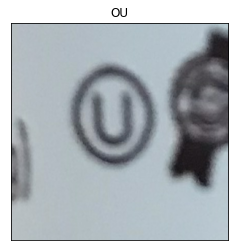

In [28]:
def load_and_preprocess_image(path): #assumes jpeg image
    """
    Preprocess image from filepath and conver to normalized image matrix.
    Returns image matrix
    """
    img = tf.io.read_file(path) #load jpeg image
    img = tf.image.decode_jpeg(img, channels=COLOR_CHANNELS) #decode jpeg compression into matrix of values
    img = tf.image.resize(img, [IMG_SIZE, IMG_SIZE]) #reshape into correct size
    # img = tf.image.rgb_to_grayscale(img)
    img /= 255.0  # normalize pixels to 0,1
    return img

#Testing out the method defined directly above
num = 3
img_path = train_paths[num]
img = load_and_preprocess_image(img_path)
label = index_to_label[train_labels[num]]
show(img, label)

Preprocessing of image files as step to make tensorflow datasets for training and validation

In [29]:
print("Create a tensorflow dataset that returns image paths")
path_ds = tf.data.Dataset.from_tensor_slices(train_paths)
for n, img_path in enumerate(path_ds.take(4)):
  print(n, img_path)

print("\nCreate a tensorflow dataset that returns images (loaded off cloud/drive, decoded, and preprocessed)")
image_ds = path_ds.map(load_and_preprocess_image, num_parallel_calls=AUTOTUNE)
for n, image in enumerate(image_ds.take(4)):
  print(n, image.shape)

print("\nCreate dataset with the labels assocaiated with each jpeg image")
label_ds = tf.data.Dataset.from_tensor_slices(tf.cast(train_labels, tf.int32))
for label in label_ds.take(4):
  print(index_to_label[label.numpy()])
  
print("\nCreate a dataset with both images and labels by zipping two of the above datasets")
image_label_ds = tf.data.Dataset.zip((image_ds, label_ds))
length_image_label_ds = len(image_label_ds)
print(f"Length: {length_image_label_ds}")
print(image_label_ds)
for img, label in image_label_ds.take(4):
  print(img.shape, label_names[label.numpy()])

Create a tensorflow dataset that returns image paths
0 tf.Tensor(b'/content/gdrive/MyDrive/kosher_app_cropped/Chaf-K/IMG_20180718_132028165.jpg', shape=(), dtype=string)
1 tf.Tensor(b'/content/gdrive/MyDrive/kosher_app_cropped/OK/IMG_2917.jpg', shape=(), dtype=string)
2 tf.Tensor(b'/content/gdrive/MyDrive/kosher_app_cropped/cRc/121045403_1075414546614810_6102197636121580441_n.jpg', shape=(), dtype=string)
3 tf.Tensor(b'/content/gdrive/MyDrive/kosher_app_cropped/OU/IMG_6276 copy.JPG', shape=(), dtype=string)

Create a tensorflow dataset that returns images (loaded off cloud/drive, decoded, and preprocessed)
0 (299, 299, 3)
1 (299, 299, 3)
2 (299, 299, 3)
3 (299, 299, 3)

Create dataset with the labels assocaiated with each jpeg image
Chaf-K
OK
cRc
OU

Create a dataset with both images and labels by zipping two of the above datasets
Length: 2153
<ZipDataset shapes: ((299, 299, 3), ()), types: (tf.float32, tf.int32)>
(299, 299, 3) Chaf-K
(299, 299, 3) OK
(299, 299, 3) cRc
(299, 299, 3) OU

### Get Logo Dataset

In addition to the dataset of collected real world data, we decided to augment our dataset with generated images. We do not have the time or resources to gather enough data ourselves for a good classifier and because the symbols are so small on a large image a CNN would require an enourmous amount of data to train well. However, we realized that all the training images are really just the kosher symbols at different angles and on different backgrounds which can be easily generated programatically. As a result, we collected the official logos of all the kosher certifying agencies and applied transform to them to mimic kosher symbols on food items. We change the zoom, angle, and background of the symbol and repeat this process many times. Examples are shown below. This generated training set of logos is then augmented to the training set we collected in stores around NYC and the network is trained on a joint tf_dataset. The generated logo data is only used for training and not for validation and testing as we want our validation and testing data to match real world data as much as possible.

#### Get Logos

In [30]:
logo_path = r'/content/gdrive/MyDrive/Logos' #filepath to folder with all of the companies logos
!ls $logo_path

1K		    CoR_2	       Kosher_in_Greece		  Peru_Kosher
3LINE		    cRc		       Kosher_Inspection_Service  RCC
AKC		    CRCanada	       Kosher_LA		  Scroll-K
Apple_K		    DK		       Kosher_Miami		  Seattle_vaad
Australia_Kosher    Earth_Kosher       K-R			  shield_K
badatz		    eidus	       KS			  Shield-Star-K
BCK		    Euro_K	       KSA			  SHK
BDK		    flag_k	       KVH			  SIKS
BFSUCD		    Heart_K	       KV_kosher		  Star-D
bird_K		    Hei-k	       Magnifying_Glass-Chaf	  Star-K
BK		    IKC		       manchester		  SW
BKA		    K		       mem			  Tablet-K
blue_ribbon_kosher  KA		       Mexico_Kosher		  tarnopol
BUOSSAD		    KAdiamond	       Midwest_Kosher		  tartikover
BVK		    KAJ		       MK			  TK
CCK		    KDM		       MK-2			  Triangle-K
C_crown		    kehila	       NSKC			  US-K
Chaf-K		    KLBD	       OK			  vismindel
chinuch		    KM		       ORB			  VK
Cincinatti_vaad     KMD_Mexico_Kosher  Oregon_K			  wisconsin
CinK		    KMSB	       OU			  zurich
C-K		    KORC	       OV


In [31]:
# Get all the logo images
data_root = pathlib.Path(logo_path)
all_image_paths = sorted(GetFilesFromPath(data_root, jpeg=False))

# Print some data about the logo dataset
logo_image_count = len(all_image_paths) #Poor name
print(f"Number of images: {logo_image_count}")
print(f"Example Paths: {all_image_paths[:3]}")

all_labels = sorted([pathlib.Path(path).parent.name for path in all_image_paths])

Root path of data /content/gdrive/MyDrive/Logos
Number of images: 87
Example Paths: ['/content/gdrive/MyDrive/Logos/1K/1K.png', '/content/gdrive/MyDrive/Logos/3LINE/3LINE.png', '/content/gdrive/MyDrive/Logos/AKC/AKC.png']


Sanity Check - Make sure none of the classes associated with the logos is a label we didn't see in the collected dataset. Also make sure the number of labels in the training set is the same as the number of images.

In [32]:
for label in all_labels:
    if label not in label_to_index_original: #shouldn't have logo of any new classes
        raise Exception(f"Label of logo has not been seen before: {label}")
for label in label_to_index_original:
    if label not in all_labels:
        raise Exception(f"Missing a logo: {label}")
assert len(all_labels) == logo_image_count #should be exactly one logo filepath per label

Delete unused logos. Earlier we deleted any classes that didn't have enough training instances to realistically classify. Here we go through those deleted classes and delete the logos assoicated with those classes. The following few cells are identical code as above when we removed the instances from the training set that had labels we were not using.

In [33]:
# Same code as used above
indexes_to_delete = []
for i in range(logo_image_count)[::-1]: #backward for deletion efficinecy
    label = all_labels[i]
    index_original = label_to_index_original[label]
    if index_original not in counted_classes:
        indexes_to_delete.append(i)
print(indexes_to_delete)

[86, 85, 84, 83, 82, 81, 80, 79, 78, 77, 76, 75, 73, 72, 71, 70, 69, 68, 67, 66, 64, 63, 62, 61, 60, 59, 58, 57, 56, 55, 54, 52, 50, 49, 48, 47, 46, 45, 44, 43, 42, 41, 40, 37, 35, 34, 33, 32, 31, 30, 29, 28, 27, 26, 25, 24, 23, 22, 21, 20, 18, 17, 15, 14, 13, 12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1, 0]


In [34]:
# Same code as above
assert logo_image_count - len(indexes_to_delete) == len(counted_classes) #only counted classes are going to be remaining
for index in indexes_to_delete:
    del all_image_paths[index]
    del all_labels[index]
print("Done deleting")

Done deleting


In [35]:
logo_image_count, len(indexes_to_delete), len(counted_classes)

(87, 78, 9)

In [36]:
print(label_to_index)

{'Chaf-K': 0, 'CoR_2': 1, 'KORC': 2, 'KSA': 3, 'KVH': 4, 'OK': 5, 'OU': 6, 'Star-K': 7, 'cRc': 8}


In [37]:
# Same code as above
for label in all_labels: #only counted classes are remaining
    index = label_to_index_original[label]
    assert index in counted_classes

In [38]:
from skimage.io import imread

In [39]:
def load_and_preprocess_png(path):
    """
    Preprocess png from filepath and conver to normalized image matrix.
    Returns images matrix
    """
    img_rgba = imread(path)
    # split RGB channels and alpha channel
    img, img_a = img_rgba[..., :3], img_rgba[..., 3]
    # make all fully transparent pixels white
    img[img_a == 0] = (255, 255, 255)
    img = tf.convert_to_tensor(img)
    img = tf.image.resize(img, [IMG_SIZE, IMG_SIZE]) #reshape into correct size
    img /= 255  # normalize pixels to 0,1
    return img

In [40]:
logo_imgs = [load_and_preprocess_png(fp) for fp in all_image_paths] #convert the list of filepaths to a list of pre-processed image matricies

# select a random image as the example image for display/testing
num_image = random.randint(0, len(logo_imgs) - 1)
example_image = logo_imgs[num_image]
example_label = all_labels[num_image]
example_image_shape = example_image.shape
example_label_index = label_to_index_original[example_label]

print(f"Label: {example_label}\nShape: {example_image_shape}\nLabel index: {example_label_index}")

Label: cRc
Shape: (299, 299, 3)
Label index: 74


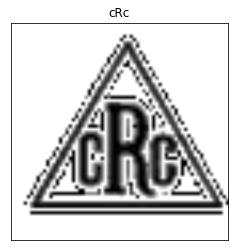

In [41]:
show(example_image, example_label)

#### Apply Data Augmentation

In [42]:
def background_augment(img):
  """
  Take image of logo with white background and return image 
  of logo overlaid on random color backgrounds
  """
  img_arr = img.numpy() # convert to np 
  t = random.randint(0,1) #randomly select 0-solid color, 1-random noise

  ran1, ran2, ran3 = random.random(), random.random(), random.random()
  ran4,ran5, ran6 = random.random()/500.0, random.random()/500.0, random.random()/400.0
  h, x, y, z = img_arr.shape
  for i in range(x):
    for j in range(y):
      if np.all(img_arr[0][i, j] >= .9): #if pixel is white or off-white
        if ( t == 0 ): #solid color background with some color variance
          img_arr[0][i,j] = (ran1+ran4*(i-j), ran2+ran5*(i+j), ran3+ran6*(i-j))
        else:  #random pixel value background
          img_arr[0][i,j] = (random.random(), random.random(), random.random())

  w = random.randint(0,2) #randomly select 0-invert colors, 1,2-reg colors
  if w:
    return tf.convert_to_tensor(img_arr)
  return 1 - tf.convert_to_tensor(img_arr) #invert colors for white logo

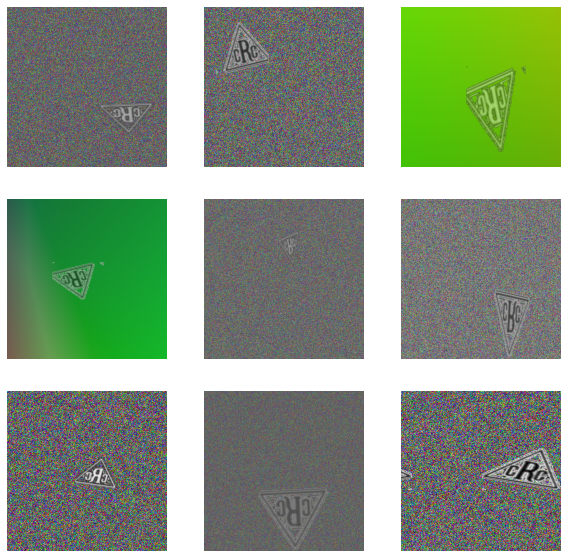

In [43]:
# All of the dataaugmentation transformation done to evrey logo 
data_augmentation = tf.keras.Sequential([
  tf.keras.layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical"),
  tf.keras.layers.experimental.preprocessing.RandomRotation(.05),
  # multiple zooms in a row because there is a limit to how much you can zoom out one layer
  tf.keras.layers.experimental.preprocessing.RandomZoom(height_factor=(0, 1), width_factor=(0, 1), fill_mode="constant", fill_value=1), #positive zoom means zoom out
  tf.keras.layers.experimental.preprocessing.RandomZoom(height_factor=(0, 1), width_factor=(0, 1), fill_mode="constant", fill_value=1),
  tf.keras.layers.experimental.preprocessing.RandomZoom(height_factor=(0, 1), width_factor=(0, 1), fill_mode="constant", fill_value=1),
  tf.keras.layers.experimental.preprocessing.RandomTranslation(
    .3, .3, fill_mode='reflect',
    interpolation='bilinear', seed=None, name=None, fill_value=1),
])

#Display the transformations on an example image
image = tf.expand_dims(example_image, 0) 
plt.figure(figsize=(10, 10))
for i in range(9):
  augmented_image = data_augmentation(image)
  augmented_image = background_augment(augmented_image)
  augmented_image = tf.image.random_saturation(augmented_image, 1, 5)
  augmented_image = tf.image.random_contrast(augmented_image, 0.2, 1)
  ax = plt.subplot(3, 3, i + 1)
  plt.imshow(augmented_image[0])
  plt.axis("off")

In [44]:
def AugmentLogo(logo_img, label_index, num_augmentations):
    """
    Given a logo image and its label, run a bunch of augmentations on it with the above 
    defined data augmentation scheme. Compile the new images into a list. Also make a
    list of the correct label given the logo and number of augementations. This will just
    be the same label_index copied num_augmentations times.
    Returns (an array of augmented images, an array of the same size consisting of the label index repeated)
    """
    images = [logo_img]
    label_indexes = [label_index]
    for i in range(num_augmentations):
        expanded_image = tf.expand_dims(logo_img, 0) 
        augmented_image = data_augmentation(expanded_image)
        augmented_image = background_augment(augmented_image)
        augmented_image = tf.image.random_saturation(augmented_image, 1, 5)
        augmented_image = tf.image.random_contrast(augmented_image, 0.2, 1)
        images.append(augmented_image[0])
        label_indexes.append(label_index)

    num_logo_images = len(images)
    assert num_logo_images == len(label_indexes)
    return images, label_indexes

In [45]:
start = time.time() #time how long the data augmentations take

num_augmentations = 99
logos_images = []
logos_label_indexes = []
#run data augmentation for every logo and compile them into a single training list
for logo_img, label in zip(logo_imgs, all_labels):
    label_index = label_to_index[label]
    logo_images, logo_label_indexes = AugmentLogo(logo_img, label_index, num_augmentations)
    logos_images.extend(logo_images) #add the augmented images to the general logo training set
    logos_label_indexes.extend(logo_label_indexes) #add the labels to the general training set

end = time.time()
print(end - start)
num_logo_images = len(logos_images)

563.3561079502106


Sanity Check
1. Make sure the model produced the correct number or images
2. Make sure the number of labels and the number of images is the same
3. Make sure the label_index values make sense
4. Make sure the label_index values make sense

In [46]:
assert (num_augmentations + 1) * len(counted_classes) == num_logo_images
assert num_logo_images == len(logos_label_indexes)
assert min(logos_label_indexes) == min(index_to_label)
assert max(logos_label_indexes) == max(index_to_label)
print("Augmentations assertions Passed")

Augmentations assertions Passed


#### Convert logo data to tf.dataset

Same code as above when converting data to tf.data.dataset

In [47]:
logo_ds = tf.data.Dataset.from_tensor_slices(logos_images)
print("\nCreate dataset with each png logo image")
print(f"Length: {len(logo_ds)}")
for n, logo_image in enumerate(logo_ds.take(4)):
  print(n, logo_image.shape)

print("\nCreate dataset with the labels assocaiated with each png logo image")
logo_label_ds = tf.data.Dataset.from_tensor_slices(tf.cast(logos_label_indexes, tf.int32))
print(f"Length: {len(logo_label_ds)}")
for label in label_ds.take(4):
  print(index_to_label[label.numpy()])

print("\nCreate a dataset with both logo images and labels by zipping two of the above datasets")
logo_image_label_ds = tf.data.Dataset.zip((logo_ds, logo_label_ds))
length_logo_image_label_ds = len(logo_image_label_ds)
print(f"Length: {length_logo_image_label_ds}")
print(image_label_ds)
for img, label in image_label_ds.take(4):
  print(img.shape, label_names[label.numpy()])


Create dataset with each png logo image
Length: 900
0 (299, 299, 3)
1 (299, 299, 3)
2 (299, 299, 3)
3 (299, 299, 3)

Create dataset with the labels assocaiated with each png logo image
Length: 900
Chaf-K
OK
cRc
OU

Create a dataset with both logo images and labels by zipping two of the above datasets
Length: 900
<ZipDataset shapes: ((299, 299, 3), ()), types: (tf.float32, tf.int32)>
(299, 299, 3) Chaf-K
(299, 299, 3) OK
(299, 299, 3) cRc
(299, 299, 3) OU


### Make Training, Validation, and Testing Datasets

Combine the two datasets (1) collected data and (2) augmented logo data into a single tf.data.dataset to train the model.

In [48]:
image_full_label_ds = image_label_ds.concatenate(logo_image_label_ds) #co
length_image_full_label_ds = len(image_full_label_ds)
print(f"Length: {length_image_full_label_ds}")
assert length_image_label_ds + length_logo_image_label_ds == length_image_full_label_ds
# ^ Sanity check with number of images: the size of the combined dataset should be equal to the sum of the sizes of the individual datasets

Length: 3053


Using the above tensorflow datasets, make the final training and validation datasets for the neural network. To improve performance we used:
- caching
- prefetch
- batching

In [49]:
#Final training dataset
start = time.time()

train_ds = image_full_label_ds.cache()
train_ds = train_ds.shuffle(SHUFFLE_SIZE)
train_ds = train_ds.batch(TRAIN_BATCH_SIZE).prefetch(buffer_size=AUTOTUNE)

for img, label in train_ds.take(2):
  print(img.shape, label.shape)

end = time.time()
print(end - start)

(32, 299, 299, 3) (32,)
(32, 299, 299, 3) (32,)
112.80948948860168


In [50]:
#Repeat process for validation dataset as well
path_ds = tf.data.Dataset.from_tensor_slices(val_paths)
image_ds = path_ds.map(load_and_preprocess_image, num_parallel_calls=AUTOTUNE)
label_ds = tf.data.Dataset.from_tensor_slices(tf.cast(val_labels, tf.int32))
image_label_ds = tf.data.Dataset.zip((image_ds, label_ds))
val_ds = image_label_ds.cache()
val_ds = image_label_ds.batch(VAL_BATCH_SIZE)

for img, label in val_ds.take(2):
  print(img.shape, label.shape)

(32, 299, 299, 3) (32,)
(32, 299, 299, 3) (32,)


In [51]:
#Repeat process for testing dataset as well
path_ds = tf.data.Dataset.from_tensor_slices(test_paths)
image_ds = path_ds.map(load_and_preprocess_image, num_parallel_calls=AUTOTUNE)
label_ds = tf.data.Dataset.from_tensor_slices(tf.cast(test_labels, tf.int32))
image_label_ds = tf.data.Dataset.zip((image_ds, label_ds))
test_ds = image_label_ds.cache()
test_ds = image_label_ds.batch(VAL_BATCH_SIZE)


for img, label in test_ds.take(2):
  print(img.shape, label.shape)

(32, 299, 299, 3) (32,)
(32, 299, 299, 3) (32,)


## **Models**

### **Imports and Installs**

In [52]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import optimizers, models, layers
import datetime
from keras.models import load_model
from keras.callbacks import ModelCheckpoint

from keras.models import Sequential
from keras.layers import Dense, Conv2D, Flatten

Downloading and setting up tensorboard for visualization and testing of models. Keras Tuner for empirical tuning of models.

In [53]:
# # Install the TF Profiler
!pip install -U tensorboard_plugin_profile
# # Load the TensorBoard notebook extension (colab specific code) used for better visualization of what the network is doing
%load_ext tensorboard

     |████████████████████████████████| 1.2MB 13.1MB/s 


In [54]:
!pip install -U keras-tuner
import kerastuner as kt #Keras Tuner is used to empirically find the best architecture for a network

     |████████████████████████████████| 71kB 7.2MB/s 
  Created wheel for keras-tuner: filename=keras_tuner-1.0.2-cp36-none-any.whl size=78939 sha256=6079668adc54a6390f5f0aab91bd9f9b8c02a9ef8e02c4c54c0119780e8ff7d8
  Stored in directory: /root/.cache/pip/wheels/bb/a1/8a/7c3de0efb3707a1701b36ebbfdbc4e67aedf6d4943a1f463d6
  Created wheel for terminaltables: filename=terminaltables-3.1.0-cp36-none-any.whl size=15358 sha256=4ccfcec3e325781ba919e1f09c6883a1d00fe1241de8ca4e4bea7746f6edbc8b
  Stored in directory: /root/.cache/pip/wheels/30/6b/50/6c75775b681fb36cdfac7f19799888ef9d8813aff9e379663e
Successfully built keras-tuner terminaltables


### **Data Augmentation**


This is the regular data augmentation that is done for our collected training data. It is also done on the logo data but will have little to no effect as the large majority of that data is already augmented and generated.

In [55]:
# https://www.tensorflow.org/api_docs/python/tf/keras/layers/experimental/preprocessing

data_augmentation = tf.keras.Sequential([
  layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical"),
  layers.experimental.preprocessing.RandomRotation(0.2),
  tf.keras.layers.experimental.preprocessing.RandomTranslation((-.3, .3), (-.3, .3), fill_mode="constant", fill_value=1), #30% each way (positive and negative and height and width)
  tf.keras.layers.experimental.preprocessing.RandomContrast(.3, seed=4)
])

### **Reused Callbacks**

In [56]:
early_stopping = tf.keras.callbacks.EarlyStopping(patience=5) #Early stopping callback that is reused repeatedly
es = early_stopping
# saving best model as you go https://machinelearningmastery.com/how-to-stop-training-deep-neural-networks-at-the-right-time-using-early-stopping/
# tensorboard callback

In [57]:
#Function to turn image into correct size for prediction
def load(filename): #Taken from and adjusted: https://stackoverflow.com/questions/43017017/keras-model-predict-for-a-single-image
   np_image = Image.open(filename)
   np_image = np.array(np_image).astype('float32')/255
   np_image = transform.resize(np_image, (IMG_SIZE, IMG_SIZE, COLOR_CHANNELS))
   np_image = np.expand_dims(np_image, axis=0)
   return np_image

def test_image(model_name, fp, cls, num=1):
  """
  Test our classifier on an image. Need to change 'num' to differnet values if you want multiple images display at once. Otherwise each image will overwrite the previous one.
  fp = filepath to image
  cls = name of the correct classification
  """
  image = load(fp)
  predict_output = model_name.predict(image)
  arg_max = np.argmax(predict_output)
  pred = label_names[arg_max]
  confidence = predict_output[0][arg_max]
  img = load_and_preprocess_image(fp)
  show(img, f"Label = {cls} | Prediction = {pred} | Confidence {confidence:.2f}", num)

###**Base Model**

In [58]:
base_model = Sequential()
base_model.add(Conv2D(64, kernel_size=3, activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, COLOR_CHANNELS)))
base_model.add(layers.MaxPooling2D((2, 2)))
base_model.add(Conv2D(128, kernel_size=3, activation='relu'))
base_model.add(layers.MaxPooling2D((2, 2)))
base_model.add(Conv2D(256, kernel_size=3, activation='relu'))
base_model.add(Conv2D(128, kernel_size=3, activation='relu'))
base_model.add(Flatten())
base_model.add(Dense(10, activation='softmax'))

base_model.compile(loss='sparse_categorical_crossentropy',
              optimizer='adam',
              metrics=['acc'])

mc = ModelCheckpoint("base_model_name.h5", monitor='val_loss')

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")   #Set up tensorboard callback for better graph visualization
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
history = base_model.fit(
      train_ds, 
      validation_data=val_ds,
      epochs=EPOCHS,
      callbacks=[tensorboard_callback, mc, early_stopping])

Epoch 1/20
96/96 [==============================] - 154s 2s/step - loss: 3.0466 - acc: 0.2849 - val_loss: 1.9690 - val_acc: 0.3506
Epoch 2/20
96/96 [==============================] - 8s 87ms/step - loss: 2.0067 - acc: 0.3120 - val_loss: 2.0008 - val_acc: 0.3506
Epoch 3/20
96/96 [==============================] - 8s 86ms/step - loss: 1.9927 - acc: 0.3129 - val_loss: 1.9562 - val_acc: 0.3506
Epoch 4/20
96/96 [==============================] - 8s 87ms/step - loss: 1.9706 - acc: 0.3213 - val_loss: 1.9454 - val_acc: 0.3506
Epoch 5/20
96/96 [==============================] - 8s 87ms/step - loss: 1.9602 - acc: 0.3348 - val_loss: 2.0057 - val_acc: 0.3506
Epoch 6/20
96/96 [==============================] - 8s 86ms/step - loss: 1.9659 - acc: 0.3243 - val_loss: 1.9312 - val_acc: 0.3485
Epoch 7/20
96/96 [==============================] - 8s 87ms/step - loss: 1.9277 - acc: 0.3270 - val_loss: 1.9355 - val_acc: 0.3658
Epoch 8/20
96/96 [==============================] - 8s 89ms/step - loss: 1.5943 - a

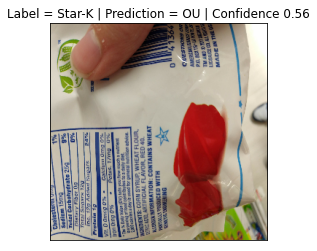

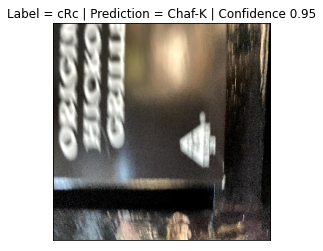

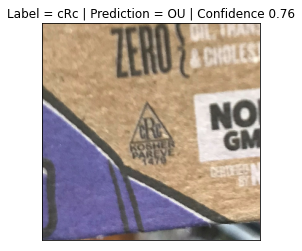

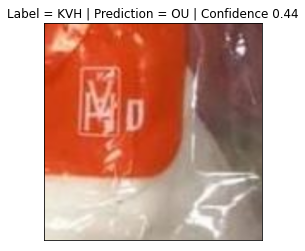

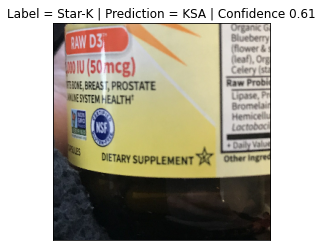

In [59]:
random_sample_locs = random.sample(range(0, len(val_paths) - 1), 5)

for i, loc in enumerate(random_sample_locs):
  image_to_guess = val_paths[loc]
  label_to_guess = label_names[val_labels[loc]]
  test_image(base_model, image_to_guess, label_to_guess, i)

### **Model from Transfer Learning (Xception)**

####***Without* finetuning...**

In [60]:
xception_model = tf.keras.applications.Xception(
    include_top=False,
    weights="imagenet",
    input_shape=(IMG_SIZE, IMG_SIZE, COLOR_CHANNELS),
    
)

xception_model.trainable = False 

global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
prediction_layer = tf.keras.layers.Dense(len(all_labels), activation='softmax')

xception_model = tf.keras.Sequential([
  data_augmentation,
  xception_model,
  global_average_layer,
  prediction_layer
])

xception_model.compile(loss='sparse_categorical_crossentropy',
              optimizer='adam',
              metrics=['acc'])

xception_no_finetuning_model_name = 'best_model_xception_no_tuning.h5'
mc = ModelCheckpoint(xception_no_finetuning_model_name, monitor='val_loss')


log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")   #Set up tensorboard callback for better graph visualization
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
history = xception_model.fit(
      train_ds, 
      validation_data=val_ds,
      epochs=EPOCHS,
      callbacks=[tensorboard_callback, mc, es])

83689472/83683744 [==============================] - 1s 0us/step
Epoch 1/20
96/96 [==============================] - 15s 120ms/step - loss: 1.8256 - acc: 0.3658 - val_loss: 1.4993 - val_acc: 0.5000
Epoch 2/20
96/96 [==============================] - 10s 107ms/step - loss: 1.3135 - acc: 0.5720 - val_loss: 1.3416 - val_acc: 0.5238
Epoch 3/20
96/96 [==============================] - 10s 108ms/step - loss: 1.1117 - acc: 0.6370 - val_loss: 1.2367 - val_acc: 0.5498
Epoch 4/20
96/96 [==============================] - 10s 108ms/step - loss: 0.9921 - acc: 0.6816 - val_loss: 1.1746 - val_acc: 0.5736
Epoch 5/20
96/96 [==============================] - 10s 108ms/step - loss: 0.9334 - acc: 0.7070 - val_loss: 1.1405 - val_acc: 0.5779
Epoch 6/20
96/96 [==============================] - 10s 108ms/step - loss: 0.8571 - acc: 0.7239 - val_loss: 1.1293 - val_acc: 0.5844
Epoch 7/20
96/96 [==============================] - 10s 108ms/step - loss: 0.8383 - acc: 0.7376 - val_loss: 1.1020 - val_acc: 0.6126
Epoc

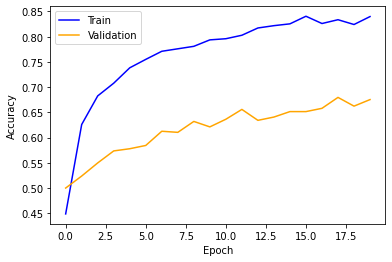

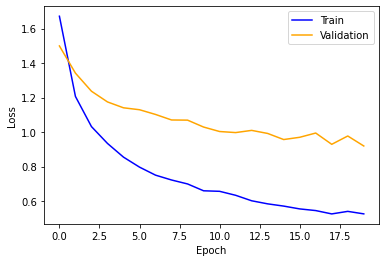

In [61]:
plot_history(history)

In [62]:
# %tensorboard --logdir logs/fit

In [63]:
xception_model_no_finetune_best = load_model(xception_no_finetuning_model_name) #Load the best model based on validation accuracy
loss, acc, report = ApplyTestSet(xception_model_no_finetune_best, test_ds, test_labels, list(label_to_index))
print(f"Test set accuracy = {acc:.2%}")
print(f"\nTest set report:\n\n{report}")

15/15 [==============================] - 43s 3s/step - loss: 0.8669 - acc: 0.6970
Test set accuracy = 69.70%

Test set report:

              precision    recall  f1-score   support

      Chaf-K       0.75      0.79      0.77        68
       CoR_2       0.57      0.46      0.51        26
        KORC       0.69      0.60      0.64        15
         KSA       0.65      0.46      0.54        28
         KVH       0.69      0.62      0.65        29
          OK       0.64      0.44      0.52        61
          OU       0.74      0.88      0.80       161
      Star-K       0.66      0.75      0.70        52
         cRc       0.47      0.41      0.44        22

    accuracy                           0.70       462
   macro avg       0.65      0.60      0.62       462
weighted avg       0.69      0.70      0.69       462



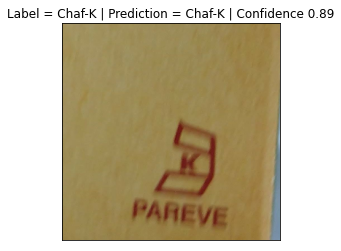

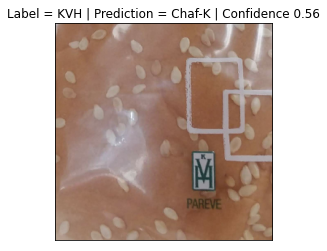

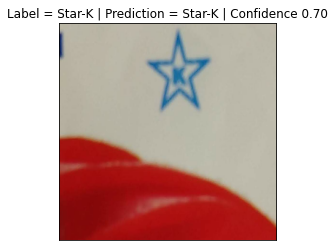

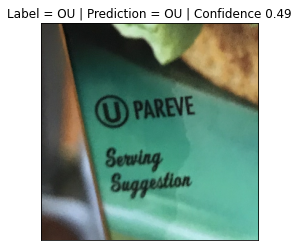

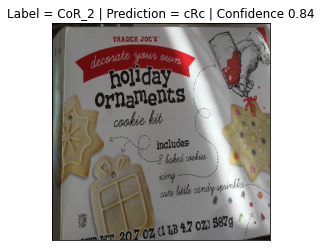

In [64]:
random_sample_locs = random.sample(range(0, len(val_paths) - 1), 5)

for i, loc in enumerate(random_sample_locs):
  image_to_guess = val_paths[loc]
  label_to_guess = label_names[val_labels[loc]]
  test_image(xception_model_no_finetune_best, image_to_guess, label_to_guess, i)

#### ***With* finetuning...**

In [65]:
xception_model = tf.keras.applications.Xception(
    include_top=False,
    weights="imagenet",
    input_shape=(IMG_SIZE, IMG_SIZE, COLOR_CHANNELS),
)
xception_model.trainable = True 
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
prediction_layer = tf.keras.layers.Dense(len(all_labels), activation='softmax')

xception_model = tf.keras.Sequential([
  xception_model,
  global_average_layer,
  prediction_layer
])

xception_model.compile(loss='sparse_categorical_crossentropy',
              optimizer='adam',
              metrics=['acc'])

xception_finetuning_model_name = 'best_model_xception_tuning.h5'
mc = ModelCheckpoint(xception_finetuning_model_name, monitor='val_loss')

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")  #Set up tensorboard callback for better graph visualization
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
history = xception_model.fit(
      train_ds, 
      validation_data=val_ds,
      epochs=EPOCHS,
      callbacks=[tensorboard_callback, mc])

Epoch 1/20
96/96 [==============================] - 51s 497ms/step - loss: 0.7583 - acc: 0.7573 - val_loss: 3.1841 - val_acc: 0.6061
Epoch 2/20
96/96 [==============================] - 46s 480ms/step - loss: 0.2245 - acc: 0.9413 - val_loss: 0.4994 - val_acc: 0.9113
Epoch 3/20
96/96 [==============================] - 46s 480ms/step - loss: 0.1356 - acc: 0.9624 - val_loss: 0.2641 - val_acc: 0.9437
Epoch 4/20
96/96 [==============================] - 46s 480ms/step - loss: 0.0860 - acc: 0.9767 - val_loss: 0.6818 - val_acc: 0.8593
Epoch 5/20
96/96 [==============================] - 46s 481ms/step - loss: 0.1280 - acc: 0.9631 - val_loss: 4.0632 - val_acc: 0.8074
Epoch 6/20
96/96 [==============================] - 46s 480ms/step - loss: 0.1291 - acc: 0.9632 - val_loss: 0.3864 - val_acc: 0.9242
Epoch 7/20
96/96 [==============================] - 46s 479ms/step - loss: 0.0462 - acc: 0.9874 - val_loss: 0.0884 - val_acc: 0.9740
Epoch 8/20
96/96 [==============================] - 46s 480ms/step - 

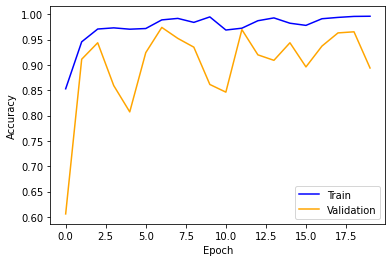

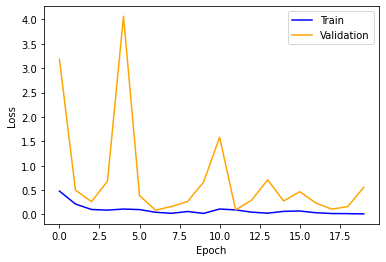

In [66]:
plot_history(history)

In [67]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

In [68]:
xception_model_finetune_best = load_model(xception_finetuning_model_name) #Load the best model based on validation accuracy
loss, acc, report = ApplyTestSet(xception_model_finetune_best, test_ds, test_labels, list(label_to_index))
print(f"Test set accuracy = {acc:.2%}")
print(f"\nTest set report:\n\n{report}")

15/15 [==============================] - 3s 159ms/step - loss: 0.5394 - acc: 0.9026
Test set accuracy = 90.26%

Test set report:

              precision    recall  f1-score   support

      Chaf-K       1.00      0.96      0.98        68
       CoR_2       0.43      1.00      0.60        26
        KORC       0.93      0.93      0.93        15
         KSA       1.00      0.75      0.86        28
         KVH       1.00      0.93      0.96        29
          OK       0.98      0.98      0.98        61
          OU       1.00      0.84      0.92       161
      Star-K       0.98      0.96      0.97        52
         cRc       0.69      0.82      0.75        22

    accuracy                           0.90       462
   macro avg       0.89      0.91      0.88       462
weighted avg       0.95      0.90      0.91       462



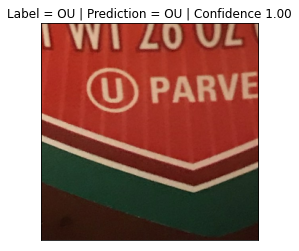

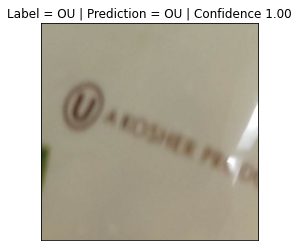

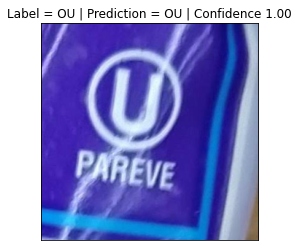

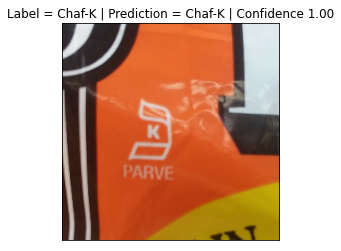

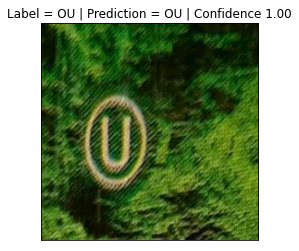

In [69]:
random_sample_locs = random.sample(range(0, len(val_paths) - 1), 5)

for i, loc in enumerate(random_sample_locs):
  image_to_guess = val_paths[loc]
  label_to_guess = label_names[val_labels[loc]]
  test_image(xception_model_finetune_best, image_to_guess, label_to_guess, i)

### Keras Tuner Model

In [70]:
def model_builder(hp):
    """
    A function for keras tuner to empirically test out different model architectures.

    As defined below this will test different number of filters, convolution layers, dense layers, and neurons per dense layer
    and will proceed to pick the best model based on the empirical results.
    """
    filters = hp.Int('filters', min_value = 64, max_value = 512, step = 64)
    num_dense = hp.Int('num_dense', min_value = 0, max_value = 3, step = 1)
    num_conv = hp.Int('num_conv', min_value = 1, max_value = 3, step = 1)
    model = tf.keras.Sequential()
    model.add(data_augmentation) #https://www.tensorflow.org/tutorials/images/data_augmentation this says this will only run during training 
    model.add(layers.Conv2D(filters, 5, padding="valid", activation="relu", strides=2, input_shape=(IMG_SIZE, IMG_SIZE, COLOR_CHANNELS)))
    for i in range(num_conv):
        model.add(layers.Conv2D(filters, 5, padding="valid", activation="relu", strides=2))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Flatten())
    model.add(layers.Dropout(0.3))
    for i in range(num_dense):
        model.add(layers.Dense(hp.Int('hidden_size', 32, 96, step=16), activation='relu'))
    model.add(layers.Dense(len(label_names), activation='softmax'))
    
    model.compile(loss='sparse_categorical_crossentropy',
              optimizer='adam',
              metrics=['acc'])
    
    return model

In [71]:
tuner = kt.Hyperband(model_builder,
                     objective = 'val_acc', # Use validation accuracy as the metric for success of a classifier
                     max_epochs = 10,
                     factor = 3,
                     directory = 'KT_model',
                     project_name = 'ADL_Final_Project')   

# https://blog.tensorflow.org/2020/01/hyperparameter-tuning-with-keras-tuner.html
tuner.search(train_ds, 
             epochs = 10, 
             validation_data=val_ds)

# Get the optimal hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials = 1)[0]

print("Done")

Trial 30 Complete [00h 01m 50s]
val_acc: 0.350649356842041

Best val_acc So Far: 0.35281383991241455
Total elapsed time: 00h 41m 51s
INFO:tensorflow:Oracle triggered exit
Done


In [72]:
# Build the model with the optimal hyperparameters and train it on the data as discovered by Keras Tuner
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") #Set up tensorboard callback for better graph visualization
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

base_model_name = 'best_base_model.h5'
mc = ModelCheckpoint(base_model_name, monitor='val_accuracy')

model = tuner.hypermodel.build(best_hps)
history = model.fit(train_ds, epochs = 10, validation_data=val_ds, callbacks=[tensorboard_callback, early_stopping, mc])
print(model.summary())

Epoch 1/10
96/96 [==============================] - 32s 327ms/step - loss: 3.1299 - acc: 0.2963 - val_loss: 1.9818 - val_acc: 0.3506
Epoch 2/10
96/96 [==============================] - 29s 307ms/step - loss: 1.9907 - acc: 0.3385 - val_loss: 2.1104 - val_acc: 0.3506
Epoch 3/10
96/96 [==============================] - 29s 306ms/step - loss: 2.0086 - acc: 0.3319 - val_loss: 1.9975 - val_acc: 0.3506
Epoch 4/10
96/96 [==============================] - 29s 305ms/step - loss: 1.9961 - acc: 0.3167 - val_loss: 2.0194 - val_acc: 0.3506
Epoch 5/10
96/96 [==============================] - 29s 306ms/step - loss: 2.0418 - acc: 0.3248 - val_loss: 2.0947 - val_acc: 0.3506
Epoch 6/10
96/96 [==============================] - 29s 306ms/step - loss: 2.0240 - acc: 0.3288 - val_loss: 2.0530 - val_acc: 0.3506
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential_1 (Sequential)    (None, 299, 299, 3)  

In [ ]:
plot_history(history)

In [74]:
# %tensorboard --logdir logs/fit

In [75]:
model = load_model(base_model_name) #Load the best model based on validation accuracy
loss, acc, report = ApplyTestSet(model, test_ds, test_labels, list(label_to_index))
print(f"Test set accuracy = {acc:.2%}")
print(f"\nTest set report:\n\n{report}")

15/15 [==============================] - 3s 179ms/step - loss: 2.0537 - acc: 0.3485
Test set accuracy = 34.85%

Test set report:

              precision    recall  f1-score   support

      Chaf-K       0.00      0.00      0.00        68
       CoR_2       0.00      0.00      0.00        26
        KORC       0.00      0.00      0.00        15
         KSA       0.00      0.00      0.00        28
         KVH       0.00      0.00      0.00        29
          OK       0.00      0.00      0.00        61
          OU       0.35      1.00      0.52       161
      Star-K       0.00      0.00      0.00        52
         cRc       0.00      0.00      0.00        22

    accuracy                           0.35       462
   macro avg       0.04      0.11      0.06       462
weighted avg       0.12      0.35      0.18       462



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


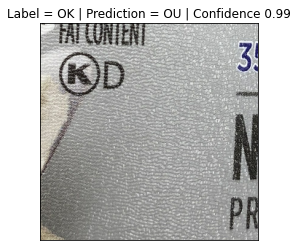

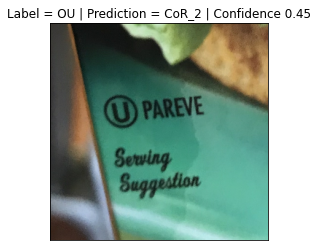

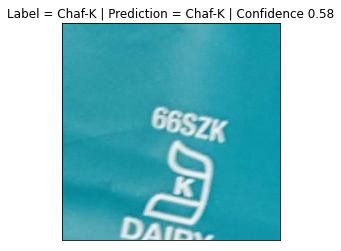

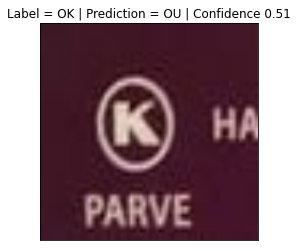

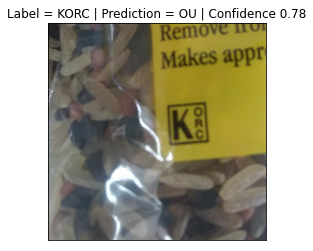

In [76]:
random_sample_locs = random.sample(range(0, len(val_paths) - 1), 5)

for i, loc in enumerate(random_sample_locs):
  image_to_guess = val_paths[loc]
  label_to_guess = label_names[val_labels[loc]]
  test_image(base_model, image_to_guess, label_to_guess, i)